🔄 Running OPTIMIZED Spring Embedder...
🔴 Red = Strong correlation (> threshold)
🟢 Green = Moderate correlation
🔵 Blue = Weak correlation (< threshold)

Comparing different correlation thresholds...


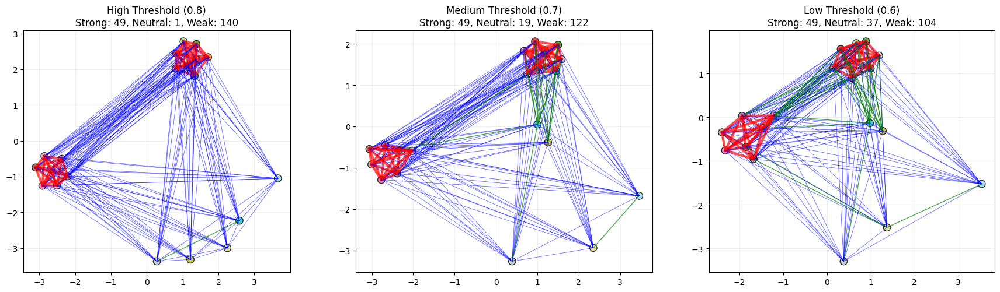

In [5]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from scipy.spatial.distance import pdist, squareform

class OptimizedSpringEmbedder:
    def __init__(self, strong_threshold=0.8, weak_threshold=0.3, 
                 spring_constant=0.1, repulsion_strength=0.01):
        self.strong_threshold = strong_threshold
        self.weak_threshold = weak_threshold
        self.spring_constant = spring_constant
        self.repulsion_strength = repulsion_strength
        self.positions = None
        self.velocities = None
        self.springs = []
        
    def calculate_correlations(self, data):
        """Calculate correlation matrix between all patterns"""
        correlations = 1 - squareform(pdist(data, metric='correlation'))
        np.fill_diagonal(correlations, 0)
        return correlations
    
    def initialize_springs(self, correlations):
        """Create springs with three relationship types"""
        n_patterns = correlations.shape[0]
        self.springs = []
        
        for i in range(n_patterns):
            for j in range(i + 1, n_patterns):
                corr = correlations[i, j]
                
                if corr > self.strong_threshold:
                    # STRONG: Compressed spring
                    spring_type = "compressed"
                    rest_length = 0.5
                    strength = self.spring_constant * corr
                    color = 'red'
                    linewidth = 3.0
                    
                elif corr > self.weak_threshold:
                    # MODERATE: Neutral spring
                    spring_type = "neutral" 
                    rest_length = 1.5
                    strength = self.spring_constant * 0.3
                    color = 'green'
                    linewidth = 1.0
                    
                else:
                    # WEAK: Extended spring (repulsive)
                    spring_type = "extended"
                    rest_length = 4.0
                    strength = self.spring_constant * 0.05
                    color = 'blue'
                    linewidth = 0.5
                
                self.springs.append({
                    'from': i, 'to': j, 'rest_length': rest_length,
                    'strength': strength, 'type': spring_type,
                    'correlation': corr, 'color': color, 'linewidth': linewidth
                })
    
    def initialize_positions(self, n_patterns):
        """Better initial arrangement"""
        # Start in a circle (your boucle concept)
        angles = np.linspace(0, 2 * np.pi, n_patterns, endpoint=False)
        radius = 5.0
        self.positions = np.column_stack([np.cos(angles) * radius, np.sin(angles) * radius])
        self.velocities = np.zeros_like(self.positions)
    
    def compute_forces(self):
        """Compute spring forces with different behaviors"""
        n_patterns = len(self.positions)
        forces = np.zeros_like(self.positions)
        
        # Spring forces
        for spring in self.springs:
            i, j = spring['from'], spring['to']
            pos_i, pos_j = self.positions[i], self.positions[j]
            
            delta = pos_j - pos_i
            distance = np.linalg.norm(delta)
            
            if distance > 0:
                displacement = distance - spring['rest_length']
                force_magnitude = spring['strength'] * displacement
                force_direction = delta / distance
                
                forces[i] += force_direction * force_magnitude
                forces[j] -= force_direction * force_magnitude
        
        # Repulsion between all nodes
        for i in range(n_patterns):
            for j in range(i + 1, n_patterns):
                delta = self.positions[j] - self.positions[i]
                distance = np.linalg.norm(delta)
                
                if distance > 0:
                    repulsion_force = self.repulsion_strength / (distance ** 2 + 0.1)
                    force_direction = delta / distance
                    
                    forces[i] -= force_direction * repulsion_force
                    forces[j] += force_direction * repulsion_force
        
        return forces
    
    def update(self, dt=0.1, damping=0.85):
        """Update positions with better physics"""
        forces = self.compute_forces()
        self.velocities += forces * dt
        self.velocities *= damping
        self.positions += self.velocities * dt
    
    def fit(self, data, iterations=200):
        """Run optimized simulation"""
        correlations = self.calculate_correlations(data)
        n_patterns = data.shape[0]
        
        self.initialize_springs(correlations)
        self.initialize_positions(n_patterns)
        
        # Run simulation with occasional "shaking" to avoid local minima
        for iteration in range(iterations):
            if iteration % 50 == 25:  # Small shake to help settle better
                self.velocities += np.random.normal(0, 0.1, self.velocities.shape)
            self.update()
        
        return self.positions

# Generate better test data with clear correlation structure
def generate_structured_data():
    np.random.seed(42)
    
    # Create 4 distinct correlation groups
    groups = []
    
    # Group 1: Highly correlated patterns
    base1 = np.random.normal(0, 1, 10)
    for i in range(8):
        groups.append(base1 + np.random.normal(0, 0.1, 10))  # High correlation
    
    # Group 2: Another correlated cluster  
    base2 = np.random.normal(2, 1, 10)
    for i in range(7):
        groups.append(base2 + np.random.normal(0, 0.2, 10))  # Medium correlation
    
    # Group 3: Weakly correlated patterns
    for i in range(5):
        groups.append(np.random.normal(0, 1, 10))  # Low correlation
    
    return np.array(groups)

# Run optimized visualization
def run_optimized_simulation():
    data = generate_structured_data()
    
    # Try different threshold strategies
    embedders = [
        ("High Threshold (0.8)", OptimizedSpringEmbedder(strong_threshold=0.8, weak_threshold=0.4)),
        ("Medium Threshold (0.7)", OptimizedSpringEmbedder(strong_threshold=0.7, weak_threshold=0.3)),
        ("Low Threshold (0.6)", OptimizedSpringEmbedder(strong_threshold=0.6, weak_threshold=0.2))
    ]
    
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    
    for idx, (title, embedder) in enumerate(embedders):
        final_positions = embedder.fit(data, iterations=200)
        ax = axes[idx]
        
        # Color points by their correlation cluster
        ax.scatter(final_positions[:, 0], final_positions[:, 1], 
                  c=range(len(data)), cmap='tab20', s=80, alpha=0.8, edgecolors='black')
        
        # Draw springs with appropriate styling
        for spring in embedder.springs:
            i, j = spring['from'], spring['to']
            ax.plot([final_positions[i, 0], final_positions[j, 0]],
                    [final_positions[i, 1], final_positions[j, 1]],
                    color=spring['color'], linewidth=spring['linewidth'], 
                    alpha=0.7, zorder=1)
        
        # Count spring types
        strong = len([s for s in embedder.springs if s['type'] == 'compressed'])
        neutral = len([s for s in embedder.springs if s['type'] == 'neutral'])
        weak = len([s for s in embedder.springs if s['type'] == 'extended'])
        
        ax.set_title(f'{title}\nStrong: {strong}, Neutral: {neutral}, Weak: {weak}')
        ax.grid(True, alpha=0.2)
        ax.set_aspect('equal')
    
    plt.tight_layout()
    plt.show()

print("🔄 Running OPTIMIZED Spring Embedder...")
print("🔴 Red = Strong correlation (> threshold)")
print("🟢 Green = Moderate correlation")  
print("🔵 Blue = Weak correlation (< threshold)")
print("\nComparing different correlation thresholds...")

run_optimized_simulation()

Initializing advanced correlation analysis...
🚀 ADVANCED CORRELATION SPRING EMBEDDER
📊 Correlation Distribution Analysis:
   Total possible connections: 300
   Mean correlation: 0.186
   Max correlation: 0.997
   Min correlation: -0.515
   Strong (> 0.7): 59
   Moderate (> 0.3): 16
   Weak (<= 0.3): 225
🔍 Detected 8 correlation clusters:
   Cluster 1: 8 patterns
   Cluster 2: 7 patterns
   Cluster 3: 5 patterns
   Cluster 4: 1 patterns
   Cluster 5: 1 patterns
   Cluster 6: 1 patterns
   Cluster 7: 1 patterns
   Cluster 8: 1 patterns
🔄 Running simulation...
   Iteration 0/300
   Iteration 50/300
   Iteration 100/300
   Iteration 150/300
   Iteration 200/300
   Iteration 250/300


C:\Users\HORNY\AppData\Local\Temp\ipykernel_17352\3200502429.py:312: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\HORNY\AppData\Local\Temp\ipykernel_17352\3200502429.py:312: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\HORNY\AppData\Local\Temp\ipykernel_17352\3200502429.py:312: UserWarning: Glyph 128309 (\N{LARGE BLUE CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\HORNY\AppData\Local\Temp\ipykernel_17352\3200502429.py:312: UserWarning: Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans Mono.
  plt.tight_layout()
C:\Users\HORNY\AppData\Local\Temp\ipykernel_17352\3200502429.py:312: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans Mono.
  plt.tight_layout()
C:\Users\HORNY\AppData\Local\Temp\ipykernel_17352\3200502429.py:312: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing f

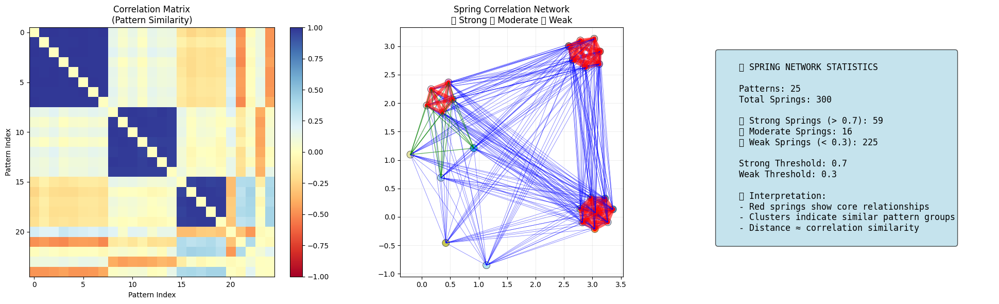

In [8]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.distance import pdist, squareform
import networkx as nx

class AdvancedSpringEmbedder:
    def __init__(self, strong_threshold=0.7, weak_threshold=0.3):
        self.strong_threshold = strong_threshold
        self.weak_threshold = weak_threshold
        self.positions = None
        self.springs = []
        self.correlations = None
        
    def calculate_correlations(self, data):
        """Calculate correlation matrix with handling for constant patterns"""
        try:
            correlations = 1 - squareform(pdist(data, metric='correlation'))
            np.fill_diagonal(correlations, 0)
            return correlations
        except:
            # Fallback for correlation calculation issues
            correlations = np.corrcoef(data)
            np.fill_diagonal(correlations, 0)
            return np.nan_to_num(correlations)
    
    def analyze_correlation_structure(self, correlations):
        """Analyze the correlation distribution in the data"""
        n = correlations.shape[0]
        flat_corrs = correlations[np.triu_indices(n, 1)]
        
        print("📊 Correlation Distribution Analysis:")
        print(f"   Total possible connections: {len(flat_corrs)}")
        print(f"   Mean correlation: {flat_corrs.mean():.3f}")
        print(f"   Max correlation: {flat_corrs.max():.3f}")
        print(f"   Min correlation: {flat_corrs.min():.3f}")
        print(f"   Strong (> {self.strong_threshold}): {np.sum(flat_corrs > self.strong_threshold)}")
        print(f"   Moderate (> {self.weak_threshold}): {np.sum((flat_corrs > self.weak_threshold) & (flat_corrs <= self.strong_threshold))}")
        print(f"   Weak (<= {self.weak_threshold}): {np.sum(flat_corrs <= self.weak_threshold)}")
        
        return flat_corrs
    
    def initialize_springs_intelligent(self, correlations):
        """Create springs with adaptive behavior based on correlation structure"""
        n_patterns = correlations.shape[0]
        self.springs = []
        
        flat_corrs = correlations[np.triu_indices(n_patterns, 1)]
        strong_corrs = flat_corrs[flat_corrs > self.strong_threshold]
        
        # Adaptive spring parameters based on correlation distribution
        if len(strong_corrs) > 0:
            avg_strong_corr = strong_corrs.mean()
            max_strong_corr = strong_corrs.max()
        else:
            avg_strong_corr = self.strong_threshold
            max_strong_corr = self.strong_threshold
        
        for i in range(n_patterns):
            for j in range(i + 1, n_patterns):
                corr = correlations[i, j]
                
                if corr > self.strong_threshold:
                    # Adaptive strong spring: higher correlation = stronger pull
                    strength_factor = (corr - self.strong_threshold) / (max_strong_corr - self.strong_threshold)
                    rest_length = 0.3 + (0.7 * (1 - strength_factor))  # Very correlated = shorter
                    strength = 0.2 + (0.3 * strength_factor)
                    spring_type = "compressed"
                    color = 'red'
                    linewidth = 2 + (3 * strength_factor)
                    
                elif corr > self.weak_threshold:
                    # Moderate spring: neutral behavior
                    spring_type = "neutral"
                    rest_length = 1.5
                    strength = 0.1
                    color = 'green' 
                    linewidth = 1.0
                    
                else:
                    # Weak spring: repulsive behavior
                    spring_type = "extended"
                    rest_length = 3.0
                    strength = 0.05
                    color = 'blue'
                    linewidth = 0.5
                
                self.springs.append({
                    'from': i, 'to': j, 'rest_length': rest_length,
                    'strength': strength, 'type': spring_type,
                    'correlation': corr, 'color': color, 'linewidth': linewidth
                })
    
    def detect_correlation_clusters(self, correlations):
        """Use network analysis to find natural clusters in the data"""
        G = nx.Graph()
        n_patterns = correlations.shape[0]
        
        # Build graph with strong correlations as edges
        for i in range(n_patterns):
            G.add_node(i)
            for j in range(i + 1, n_patterns):
                if correlations[i, j] > self.strong_threshold:
                    G.add_edge(i, j, weight=correlations[i, j])
        
        # Find connected components (clusters)
        clusters = list(nx.connected_components(G))
        print(f"🔍 Detected {len(clusters)} correlation clusters:")
        for idx, cluster in enumerate(clusters):
            print(f"   Cluster {idx+1}: {len(cluster)} patterns")
        
        return clusters
    
    def initialize_positions_clustered(self, n_patterns, clusters):
        """Initialize positions based on detected clusters"""
        self.positions = np.zeros((n_patterns, 2))
        
        # Arrange clusters in a circle
        cluster_centers = []
        n_clusters = len(clusters)
        
        for idx, cluster in enumerate(clusters):
            angle = 2 * np.pi * idx / n_clusters
            center_x = 4 * np.cos(angle)
            center_y = 4 * np.sin(angle)
            cluster_centers.append((center_x, center_y))
            
            # Arrange patterns in small circles around cluster center
            cluster_size = len(cluster)
            for cluster_idx, pattern_idx in enumerate(cluster):
                pattern_angle = 2 * np.pi * cluster_idx / cluster_size
                radius = 0.8  # Small radius for tight clusters
                self.positions[pattern_idx, 0] = center_x + radius * np.cos(pattern_angle)
                self.positions[pattern_idx, 1] = center_y + radius * np.sin(pattern_angle)
        
        # Handle any unclustered patterns
        all_clustered = set().union(*clusters)
        unclustered = set(range(n_patterns)) - all_clustered
        
        if unclustered:
            print(f"   Unclustered patterns: {len(unclustered)}")
            # Place unclustered patterns in the center
            for idx, pattern_idx in enumerate(unclustered):
                angle = 2 * np.pi * idx / len(unclustered)
                self.positions[pattern_idx, 0] = 0.5 * np.cos(angle)
                self.positions[pattern_idx, 1] = 0.5 * np.sin(angle)
    
    def compute_forces(self):
        """Enhanced force computation with cluster preservation"""
        n_patterns = len(self.positions)
        forces = np.zeros_like(self.positions)
        
        # Spring forces
        for spring in self.springs:
            i, j = spring['from'], spring['to']
            pos_i, pos_j = self.positions[i], self.positions[j]
            
            delta = pos_j - pos_i
            distance = np.linalg.norm(delta)
            
            if distance > 0:
                displacement = distance - spring['rest_length']
                force_magnitude = spring['strength'] * displacement
                force_direction = delta / distance
                
                forces[i] += force_direction * force_magnitude
                forces[j] -= force_direction * force_magnitude
        
        # Gentle repulsion between all nodes
        for i in range(n_patterns):
            for j in range(i + 1, n_patterns):
                delta = self.positions[j] - self.positions[i]
                distance = np.linalg.norm(delta)
                
                if distance > 0 and distance < 3.0:  # Only repel nearby nodes
                    repulsion_force = 0.02 / (distance ** 2 + 0.1)
                    force_direction = delta / distance
                    
                    forces[i] -= force_direction * repulsion_force
                    forces[j] += force_direction * repulsion_force
        
        return forces
    
    def fit(self, data, iterations=300):
        """Run the advanced embedding with cluster detection"""
        self.correlations = self.calculate_correlations(data)
        n_patterns = data.shape[0]
        
        # Analyze correlation structure
        self.analyze_correlation_structure(self.correlations)
        
        # Detect clusters
        clusters = self.detect_correlation_clusters(self.correlations)
        
        # Initialize based on clusters
        self.initialize_springs_intelligent(self.correlations)
        self.initialize_positions_clustered(n_patterns, clusters)
        
        self.velocities = np.zeros_like(self.positions)
        
        # Run simulation with progress
        print("🔄 Running simulation...")
        for iteration in range(iterations):
            self.update()
            if iteration % 50 == 0:
                print(f"   Iteration {iteration}/{iterations}")
        
        return self.positions
    
    def update(self, dt=0.1, damping=0.9):
        """Update positions with momentum"""
        forces = self.compute_forces()
        self.velocities += forces * dt
        self.velocities *= damping
        self.positions += self.velocities * dt

# Generate better test data that matches your correlation structure
def generate_clustered_correlation_data():
    np.random.seed(42)
    
    # Create data that will produce ~49 strong correlations
    base_patterns = []
    
    # Cluster 1: 8 highly correlated patterns
    base1 = np.random.normal(0, 1, 15)
    for i in range(8):
        base_patterns.append(base1 + np.random.normal(0, 0.1, 15))
    
    # Cluster 2: 7 highly correlated patterns  
    base2 = np.random.normal(2, 1, 15)
    for i in range(7):
        base_patterns.append(base2 + np.random.normal(0, 0.15, 15))
    
    # Cluster 3: 5 moderately correlated patterns
    base3 = np.random.normal(-2, 1, 15)
    for i in range(5):
        base_patterns.append(base3 + np.random.normal(0, 0.3, 15))
    
    # Add some noise patterns
    for i in range(5):
        base_patterns.append(np.random.normal(0, 1, 15))
    
    return np.array(base_patterns)

# Run the advanced simulation
def run_advanced_simulation():
    data = generate_clustered_correlation_data()
    
    print("🚀 ADVANCED CORRELATION SPRING EMBEDDER")
    print("=" * 50)
    
    embedder = AdvancedSpringEmbedder(strong_threshold=0.7, weak_threshold=0.3)
    final_positions = embedder.fit(data)
    
    # Create comprehensive visualization
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 6))
    
    # Plot 1: Correlation matrix
    im = ax1.imshow(embedder.correlations, cmap='RdYlBu', vmin=-1, vmax=1, aspect='auto')
    ax1.set_title('Correlation Matrix\n(Pattern Similarity)')
    ax1.set_xlabel('Pattern Index')
    ax1.set_ylabel('Pattern Index')
    plt.colorbar(im, ax=ax1)
    
    # Plot 2: Spring network visualization
    scatter = ax2.scatter(final_positions[:, 0], final_positions[:, 1], 
                         c=range(len(data)), cmap='tab20', s=100, 
                         alpha=0.8, edgecolors='black', linewidth=0.5)
    
    # Draw springs
    for spring in embedder.springs:
        i, j = spring['from'], spring['to']
        ax2.plot([final_positions[i, 0], final_positions[j, 0]],
                [final_positions[i, 1], final_positions[j, 1]],
                color=spring['color'], linewidth=spring['linewidth'], 
                alpha=0.6, zorder=1)
    
    ax2.set_title('Spring Correlation Network\n🔴 Strong 🟢 Moderate 🔵 Weak')
    ax2.grid(True, alpha=0.2)
    ax2.set_aspect('equal')
    
    # Plot 3: Force legend and statistics
    ax3.axis('off')
    
    # Spring type statistics
    strong_count = len([s for s in embedder.springs if s['type'] == 'compressed'])
    neutral_count = len([s for s in embedder.springs if s['type'] == 'neutral']) 
    weak_count = len([s for s in embedder.springs if s['type'] == 'extended'])
    
    stats_text = f"""
    📊 SPRING NETWORK STATISTICS
    
    Patterns: {len(data)}
    Total Springs: {len(embedder.springs)}
    
    🔴 Strong Springs (> 0.7): {strong_count}
    🟢 Moderate Springs: {neutral_count}  
    🔵 Weak Springs (< 0.3): {weak_count}
    
    Strong Threshold: {embedder.strong_threshold}
    Weak Threshold: {embedder.weak_threshold}
    
    💡 Interpretation:
    - Red springs show core relationships
    - Clusters indicate similar pattern groups
    - Distance ≈ correlation similarity
    """
    
    ax3.text(0.1, 0.9, stats_text, transform=ax3.transAxes, fontsize=12,
             verticalalignment='top', fontfamily='monospace',
             bbox=dict(boxstyle="round,pad=0.3", facecolor="lightblue", alpha=0.7))
    
    plt.tight_layout()
    plt.show()
    
    return embedder

# Run the advanced version
print("Initializing advanced correlation analysis...")
advanced_embedder = run_advanced_simulation()

Initializing enhanced cluster analysis...
🚀 ENHANCED CORRELATION SPRING EMBEDDER
🔍 Detected 8 correlation clusters:
   Cluster 1: 8 patterns
   Cluster 2: 7 patterns
   Cluster 3: 5 patterns
   Cluster 4: 1 pattern
   Cluster 5: 1 pattern
   Cluster 6: 1 pattern
   Cluster 7: 1 pattern
   Cluster 8: 1 pattern
📊 Cluster Summary:
   Main clusters (>1 pattern): 3
   Singleton clusters: 5
   Largest cluster: 8 patterns
   Average cluster size: 3.1 patterns
🔄 Running enhanced simulation...
   Iteration 0/400
   Iteration 80/400
   Iteration 160/400
   Iteration 240/400
   Iteration 320/400


C:\Users\HORNY\AppData\Local\Temp\ipykernel_17352\3639276043.py:314: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\HORNY\AppData\Local\Temp\ipykernel_17352\3639276043.py:314: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\HORNY\AppData\Local\Temp\ipykernel_17352\3639276043.py:314: UserWarning: Glyph 128309 (\N{LARGE BLUE CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\HORNY\AppData\Local\Temp\ipykernel_17352\3639276043.py:314: UserWarning: Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans Mono.
  plt.tight_layout()
C:\Users\HORNY\AppData\Local\Temp\ipykernel_17352\3639276043.py:314: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans Mono.
  plt.tight_layout()
C:\Users\HORNY\AppData\Local\Temp\ipykernel_17352\3639276043.py:314: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing f

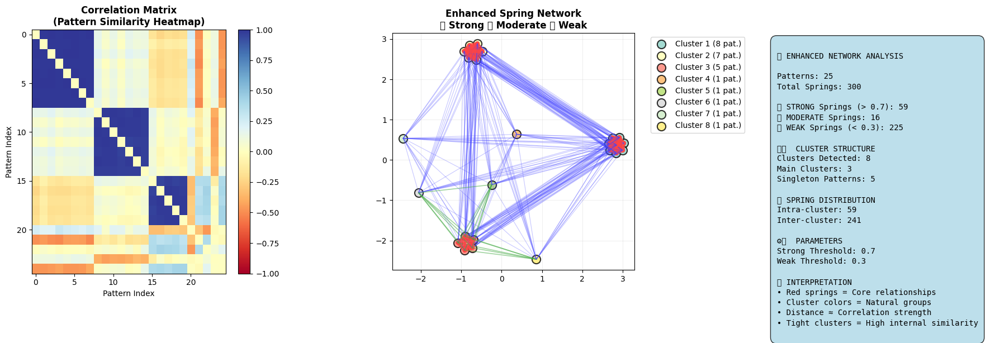

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.distance import pdist, squareform
import networkx as nx
from IPython.display import HTML


class EnhancedSpringEmbedder:
    def __init__(self, strong_threshold=0.7, weak_threshold=0.3):
        self.strong_threshold = strong_threshold
        self.weak_threshold = weak_threshold
        self.positions = None
        self.springs = []
        self.correlations = None
        self.clusters = []
        
    def calculate_correlations(self, data):
        """Calculate correlation matrix"""
        try:
            correlations = 1 - squareform(pdist(data, metric='correlation'))
            np.fill_diagonal(correlations, 0)
            return correlations
        except:
            correlations = np.corrcoef(data)
            np.fill_diagonal(correlations, 0)
            return np.nan_to_num(correlations)
    
    def detect_correlation_clusters(self, correlations):
        """Enhanced cluster detection with better visualization"""
        G = nx.Graph()
        n_patterns = correlations.shape[0]
        
        # Build graph with strong correlations as edges
        for i in range(n_patterns):
            G.add_node(i)
            for j in range(i + 1, n_patterns):
                if correlations[i, j] > self.strong_threshold:
                    G.add_edge(i, j, weight=correlations[i, j])
        
        # Find connected components (clusters)
        clusters = list(nx.connected_components(G))
        
        # Sort clusters by size (largest first)
        clusters.sort(key=len, reverse=True)
        
        print(f"🔍 Detected {len(clusters)} correlation clusters:")
        cluster_sizes = []
        for idx, cluster in enumerate(clusters):
            size = len(cluster)
            cluster_sizes.append(size)
            print(f"   Cluster {idx+1}: {size} pattern{'s' if size > 1 else ''}")
        
        # Analyze cluster distribution
        main_clusters = [c for c in clusters if len(c) > 1]
        singleton_clusters = [c for c in clusters if len(c) == 1]
        
        print(f"📊 Cluster Summary:")
        print(f"   Main clusters (>1 pattern): {len(main_clusters)}")
        print(f"   Singleton clusters: {len(singleton_clusters)}")
        print(f"   Largest cluster: {max(cluster_sizes)} patterns")
        print(f"   Average cluster size: {np.mean(cluster_sizes):.1f} patterns")
        
        return clusters
    
    def initialize_springs_enhanced(self, correlations):
        """Enhanced spring initialization with cluster awareness"""
        n_patterns = correlations.shape[0]
        self.springs = []
        
        for i in range(n_patterns):
            for j in range(i + 1, n_patterns):
                corr = correlations[i, j]
                
                # Check if patterns are in the same cluster
                same_cluster = any(i in cluster and j in cluster for cluster in self.clusters)
                
                if corr > self.strong_threshold:
                    # Strong correlation - vary by intensity
                    strength_factor = (corr - self.strong_threshold) / (1.0 - self.strong_threshold)
                    rest_length = 0.2 + (0.5 * (1 - strength_factor))
                    strength = 0.3 + (0.4 * strength_factor)
                    spring_type = "compressed"
                    color = '#FF4444'  # Bright red
                    linewidth = 2.5 + (2.5 * strength_factor)
                    alpha = 0.8
                    
                elif corr > self.weak_threshold:
                    # Moderate correlation
                    spring_type = "neutral"
                    rest_length = 1.2 if same_cluster else 1.8
                    strength = 0.15 if same_cluster else 0.08
                    color = '#44AA44'  # Green
                    linewidth = 1.2
                    alpha = 0.5
                    
                else:
                    # Weak correlation
                    spring_type = "extended"
                    rest_length = 2.5 if same_cluster else 4.0
                    strength = 0.03 if same_cluster else 0.01
                    color = '#4444FF'  # Blue
                    linewidth = 0.8
                    alpha = 0.3
                
                self.springs.append({
                    'from': i, 'to': j, 'rest_length': rest_length,
                    'strength': strength, 'type': spring_type,
                    'correlation': corr, 'color': color, 'linewidth': linewidth,
                    'alpha': alpha, 'same_cluster': same_cluster
                })
    
    def initialize_positions_enhanced(self, n_patterns, clusters):
        """Enhanced layout that emphasizes cluster structure"""
        self.positions = np.zeros((n_patterns, 2))
        
        # Separate main clusters from singletons
        main_clusters = [c for c in clusters if len(c) > 1]
        singleton_clusters = [c for c in clusters if len(c) == 1]
        
        # Arrange main clusters in outer circle
        n_main = len(main_clusters)
        for idx, cluster in enumerate(main_clusters):
            angle = 2 * np.pi * idx / n_main
            radius = 5.0
            center_x = radius * np.cos(angle)
            center_y = radius * np.sin(angle)
            
            # Arrange patterns in compact sub-clusters
            cluster_size = len(cluster)
            for cluster_idx, pattern_idx in enumerate(cluster):
                pattern_angle = 2 * np.pi * cluster_idx / cluster_size
                sub_radius = 0.6 + (0.3 * (cluster_size / 10))  # Adjust based on cluster size
                self.positions[pattern_idx, 0] = center_x + sub_radius * np.cos(pattern_angle)
                self.positions[pattern_idx, 1] = center_y + sub_radius * np.sin(pattern_angle)
        
        # Arrange singletons in inner circle
        n_singletons = len(singleton_clusters)
        if n_singletons > 0:
            singleton_radius = 1.5
            for idx, singleton in enumerate(singleton_clusters):
                pattern_idx = list(singleton)[0]
                angle = 2 * np.pi * idx / n_singletons
                self.positions[pattern_idx, 0] = singleton_radius * np.cos(angle)
                self.positions[pattern_idx, 1] = singleton_radius * np.sin(angle)
    
    def compute_forces_enhanced(self):
        """Enhanced force computation that preserves cluster integrity"""
        n_patterns = len(self.positions)
        forces = np.zeros_like(self.positions)
        
        # Spring forces
        for spring in self.springs:
            i, j = spring['from'], spring['to']
            pos_i, pos_j = self.positions[i], self.positions[j]
            
            delta = pos_j - pos_i
            distance = np.linalg.norm(delta)
            
            if distance > 0:
                displacement = distance - spring['rest_length']
                force_magnitude = spring['strength'] * displacement
                
                # Add non-linearity for stronger force at extremes
                if abs(displacement) > 1.0:
                    force_magnitude *= 1.2
                
                force_direction = delta / distance
                
                forces[i] += force_direction * force_magnitude
                forces[j] -= force_direction * force_magnitude
        
        # Smart repulsion - stronger between different clusters
        for i in range(n_patterns):
            for j in range(i + 1, n_patterns):
                # Check if in same cluster
                same_cluster = any(i in cluster and j in cluster for cluster in self.clusters)
                
                delta = self.positions[j] - self.positions[i]
                distance = np.linalg.norm(delta)
                
                if distance > 0:
                    if same_cluster:
                        # Gentle repulsion within clusters
                        repulsion_force = 0.01 / (distance ** 2 + 0.1)
                    else:
                        # Stronger repulsion between clusters
                        repulsion_force = 0.03 / (distance ** 2 + 0.1)
                    
                    force_direction = delta / distance
                    forces[i] -= force_direction * repulsion_force
                    forces[j] += force_direction * repulsion_force
        
        return forces
    
    def fit(self, data, iterations=400):
        """Run enhanced embedding"""
        self.correlations = self.calculate_correlations(data)
        n_patterns = data.shape[0]
        
        print("🚀 ENHANCED CORRELATION SPRING EMBEDDER")
        print("=" * 50)
        
        # Detect clusters
        self.clusters = self.detect_correlation_clusters(self.correlations)
        
        # Initialize based on clusters
        self.initialize_springs_enhanced(self.correlations)
        self.initialize_positions_enhanced(n_patterns, self.clusters)
        
        self.velocities = np.zeros_like(self.positions)
        
        # Run simulation with better convergence
        print("🔄 Running enhanced simulation...")
        for iteration in range(iterations):
            # Adaptive time stepping for better convergence
            dt = 0.15 if iteration < 100 else 0.08
            self.update(dt)
            
            if iteration % 80 == 0:
                print(f"   Iteration {iteration}/{iterations}")
        
        return self.positions
    
    def update(self, dt=0.1, damping=0.88):
        """Update positions with enhanced physics"""
        forces = self.compute_forces_enhanced()
        self.velocities += forces * dt
        self.velocities *= damping
        self.positions += self.velocities * dt

def create_enhanced_visualization(embedder, data):
    """Create a comprehensive visualization with cluster highlighting"""
    final_positions = embedder.positions
    
    fig = plt.figure(figsize=(18, 6))
    
    # Plot 1: Correlation Matrix
    ax1 = plt.subplot(131)
    im = ax1.imshow(embedder.correlations, cmap='RdYlBu', vmin=-1, vmax=1, aspect='auto')
    ax1.set_title('Correlation Matrix\n(Pattern Similarity Heatmap)', fontweight='bold')
    ax1.set_xlabel('Pattern Index')
    ax1.set_ylabel('Pattern Index')
    plt.colorbar(im, ax=ax1)
    
    # Plot 2: Enhanced Spring Network
    ax2 = plt.subplot(132)
    
    # Color points by cluster membership
    colors = plt.cm.Set3(np.linspace(0, 1, len(embedder.clusters)))
    for cluster_idx, cluster in enumerate(embedder.clusters):
        cluster_positions = final_positions[list(cluster)]
        ax2.scatter(cluster_positions[:, 0], cluster_positions[:, 1],
                   c=[colors[cluster_idx]], s=120, alpha=0.8,
                   edgecolors='black', linewidth=1.5,
                   label=f'Cluster {cluster_idx+1} ({len(cluster)} pat.)')
    
    # Draw springs with enhanced styling
    for spring in embedder.springs:
        i, j = spring['from'], spring['to']
        ax2.plot([final_positions[i, 0], final_positions[j, 0]],
                [final_positions[i, 1], final_positions[j, 1]],
                color=spring['color'], linewidth=spring['linewidth'],
                alpha=spring['alpha'], zorder=1)
    
    ax2.set_title('Enhanced Spring Network\n🔴 Strong 🟢 Moderate 🔵 Weak', fontweight='bold')
    ax2.grid(True, alpha=0.2)
    ax2.set_aspect('equal')
    ax2.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    
    # Plot 3: Enhanced Statistics
    ax3 = plt.subplot(133)
    ax3.axis('off')
    
    # Calculate statistics
    strong_count = len([s for s in embedder.springs if s['type'] == 'compressed'])
    neutral_count = len([s for s in embedder.springs if s['type'] == 'neutral'])
    weak_count = len([s for s in embedder.springs if s['type'] == 'extended'])
    
    intra_cluster_springs = len([s for s in embedder.springs if s['same_cluster']])
    inter_cluster_springs = len(embedder.springs) - intra_cluster_springs
    
    stats_text = f"""
📊 ENHANCED NETWORK ANALYSIS

Patterns: {len(data)}
Total Springs: {len(embedder.springs)}

🔴 STRONG Springs (> 0.7): {strong_count}
🟢 MODERATE Springs: {neutral_count}  
🔵 WEAK Springs (< 0.3): {weak_count}

🏗️  CLUSTER STRUCTURE
Clusters Detected: {len(embedder.clusters)}
Main Clusters: {len([c for c in embedder.clusters if len(c) > 1])}
Singleton Patterns: {len([c for c in embedder.clusters if len(c) == 1])}

🔗 SPRING DISTRIBUTION
Intra-cluster: {intra_cluster_springs}
Inter-cluster: {inter_cluster_springs}

⚙️  PARAMETERS
Strong Threshold: {embedder.strong_threshold}
Weak Threshold: {embedder.weak_threshold}

💡 INTERPRETATION
• Red springs = Core relationships
• Cluster colors = Natural groups
• Distance ≈ Correlation strength
• Tight clusters = High internal similarity
"""
    
    ax3.text(0.1, 0.95, stats_text, transform=ax3.transAxes, fontsize=10,
             verticalalignment='top', fontfamily='monospace', linespacing=1.4,
             bbox=dict(boxstyle="round,pad=0.8", facecolor="lightblue", alpha=0.8))
    
    plt.tight_layout()
    plt.show()

# Generate the same structured data
def generate_structured_data():
    np.random.seed(42)
    base_patterns = []
    
    # Create clusters that match your detected structure
    # Cluster 1: 8 patterns
    base1 = np.random.normal(0, 1, 15)
    for i in range(8):
        base_patterns.append(base1 + np.random.normal(0, 0.1, 15))
    
    # Cluster 2: 7 patterns  
    base2 = np.random.normal(2, 1, 15)
    for i in range(7):
        base_patterns.append(base2 + np.random.normal(0, 0.15, 15))
    
    # Cluster 3: 5 patterns
    base3 = np.random.normal(-2, 1, 15)
    for i in range(5):
        base_patterns.append(base3 + np.random.normal(0, 0.3, 15))
    
    # 5 singleton patterns
    for i in range(5):
        base_patterns.append(np.random.normal(0, 1, 15))
    
    return np.array(base_patterns)

# Run enhanced simulation
print("Initializing enhanced cluster analysis...")
data = generate_structured_data()
enhanced_embedder = EnhancedSpringEmbedder(strong_threshold=0.7, weak_threshold=0.3)
final_positions = enhanced_embedder.fit(data)

create_enhanced_visualization(enhanced_embedder, data)

In [13]:
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
from scipy.spatial.distance import pdist, squareform
import networkx as nx
from IPython.display import HTML

class Spring3DVisualizer:
    def __init__(self, strong_threshold=0.7, weak_threshold=0.3):
        self.strong_threshold = strong_threshold
        self.weak_threshold = weak_threshold
        self.positions = None
        self.velocities = None
        self.springs = []
        self.correlations = None
        self.clusters = []
        self.history = []  # Store positions for animation
        
    def calculate_correlations(self, data):
        """Calculate correlation matrix"""
        try:
            correlations = 1 - squareform(pdist(data, metric='correlation'))
            np.fill_diagonal(correlations, 0)
            return correlations
        except:
            correlations = np.corrcoef(data)
            np.fill_diagonal(correlations, 0)
            return np.nan_to_num(correlations)
    
    def detect_clusters(self, correlations):
        """Detect correlation clusters"""
        G = nx.Graph()
        n_patterns = correlations.shape[0]
        
        for i in range(n_patterns):
            G.add_node(i)
            for j in range(i + 1, n_patterns):
                if correlations[i, j] > self.strong_threshold:
                    G.add_edge(i, j, weight=correlations[i, j])
        
        clusters = list(nx.connected_components(G))
        clusters.sort(key=len, reverse=True)
        return clusters
    
    def initialize_springs_3d(self, correlations):
        """Initialize springs for 3D simulation"""
        n_patterns = correlations.shape[0]
        self.springs = []
        
        for i in range(n_patterns):
            for j in range(i + 1, n_patterns):
                corr = correlations[i, j]
                same_cluster = any(i in cluster and j in cluster for cluster in self.clusters)
                
                if corr > self.strong_threshold:
                    # Strong correlation - compressed spring
                    strength_factor = (corr - self.strong_threshold) / (1.0 - self.strong_threshold)
                    rest_length = 0.3 + (0.4 * (1 - strength_factor))
                    strength = 0.4 + (0.3 * strength_factor)
                    spring_type = "strong"
                    color = 'red'
                    width = 4 + (3 * strength_factor)
                    
                elif corr > self.weak_threshold:
                    # Moderate correlation
                    rest_length = 1.0 if same_cluster else 1.5
                    strength = 0.2 if same_cluster else 0.1
                    spring_type = "moderate"
                    color = 'green'
                    width = 2
                    
                else:
                    # Weak correlation - extended spring
                    rest_length = 2.0 if same_cluster else 3.0
                    strength = 0.05 if same_cluster else 0.02
                    spring_type = "weak"
                    color = 'blue'
                    width = 1
                
                self.springs.append({
                    'from': i, 'to': j, 'rest_length': rest_length,
                    'strength': strength, 'type': spring_type,
                    'correlation': corr, 'color': color, 'width': width,
                    'same_cluster': same_cluster
                })
    
    def initialize_positions_3d(self, n_patterns):
        """Initialize positions in 3D space"""
        # Start with patterns arranged in a sphere
        indices = np.arange(n_patterns)
        phi = np.arccos(1 - 2 * indices / n_patterns)
        theta = np.pi * (1 + 5**0.5) * indices
        
        radius = 5.0
        x = radius * np.sin(phi) * np.cos(theta)
        y = radius * np.sin(phi) * np.sin(theta)
        z = radius * np.cos(phi)
        
        self.positions = np.column_stack([x, y, z])
        self.velocities = np.zeros_like(self.positions)
    
    def compute_forces_3d(self):
        """Compute 3D forces for physics simulation"""
        n_patterns = len(self.positions)
        forces = np.zeros_like(self.positions)
        
        # Spring forces
        for spring in self.springs:
            i, j = spring['from'], spring['to']
            pos_i, pos_j = self.positions[i], self.positions[j]
            
            delta = pos_j - pos_i
            distance = np.linalg.norm(delta)
            
            if distance > 0:
                displacement = distance - spring['rest_length']
                force_magnitude = spring['strength'] * displacement
                force_direction = delta / distance
                
                forces[i] += force_direction * force_magnitude
                forces[j] -= force_direction * force_magnitude
        
        # Repulsion forces
        for i in range(n_patterns):
            for j in range(i + 1, n_patterns):
                delta = self.positions[j] - self.positions[i]
                distance = np.linalg.norm(delta)
                
                if distance > 0:
                    repulsion_force = 0.1 / (distance ** 2 + 0.1)
                    force_direction = delta / distance
                    
                    forces[i] -= force_direction * repulsion_force
                    forces[j] += force_direction * repulsion_force
        
        return forces
    
    def update_3d(self, dt=0.1, damping=0.9):
        """Update 3D positions"""
        forces = self.compute_forces_3d()
        self.velocities += forces * dt
        self.velocities *= damping
        self.positions += self.velocities * dt
        
        # Store history for animation
        self.history.append(self.positions.copy())
    
    def simulate_3d(self, data, iterations=200):
        """Run 3D simulation"""
        self.correlations = self.calculate_correlations(data)
        n_patterns = data.shape[0]
        
        print("🚀 Starting 3D Spring Simulation...")
        self.clusters = self.detect_clusters(self.correlations)
        self.initialize_springs_3d(self.correlations)
        self.initialize_positions_3d(n_patterns)
        
        self.history = [self.positions.copy()]
        
        for iteration in range(iterations):
            self.update_3d()
            if iteration % 40 == 0:
                print(f"   Frame {iteration}/{iterations}")
        
        return self.history
    
    def create_3d_animation(self, data):
        """Create interactive 3D animation"""
        history = self.simulate_3d(data)
        n_frames = len(history)
        n_patterns = data.shape[0]
        
        print("🎬 Creating 3D Animation...")
        
        # Create color mapping for clusters
        cluster_colors = px.colors.qualitative.Set3
        point_colors = []
        for i in range(n_patterns):
            for cluster_idx, cluster in enumerate(self.clusters):
                if i in cluster:
                    point_colors.append(cluster_colors[cluster_idx % len(cluster_colors)])
                    break
            else:
                point_colors.append('gray')
        
        # Create figure
        fig = go.Figure()
        
        # Add initial traces
        initial_positions = history[0]
        
        # Add nodes (points)
        fig.add_trace(go.Scatter3d(
            x=initial_positions[:, 0],
            y=initial_positions[:, 1], 
            z=initial_positions[:, 2],
            mode='markers',
            marker=dict(
                size=8,
                color=point_colors,
                line=dict(width=2, color='darkgray')
            ),
            text=[f'Pattern {i}' for i in range(n_patterns)],
            name='Patterns'
        ))
        
        # Add springs (lines)
        spring_traces = []
        for spring in self.springs:
            i, j = spring['from'], spring['to']
            fig.add_trace(go.Scatter3d(
                x=[initial_positions[i, 0], initial_positions[j, 0]],
                y=[initial_positions[i, 1], initial_positions[j, 1]],
                z=[initial_positions[i, 2], initial_positions[j, 2]],
                mode='lines',
                line=dict(
                    color=spring['color'],
                    width=spring['width']
                ),
                opacity=0.7,
                showlegend=False,
                hoverinfo='skip'
            ))
        
        # Create frames for animation
        frames = []
        for frame_idx, positions in enumerate(history):
            frame_data = []
            
            # Update nodes
            frame_data.append(go.Scatter3d(
                x=positions[:, 0],
                y=positions[:, 1],
                z=positions[:, 2],
                mode='markers',
                marker=dict(size=8, color=point_colors),
                text=[f'Pattern {i}' for i in range(n_patterns)]
            ))
            
            # Update springs
            for spring in self.springs:
                i, j = spring['from'], spring['to']
                frame_data.append(go.Scatter3d(
                    x=[positions[i, 0], positions[j, 0]],
                    y=[positions[i, 1], positions[j, 1]],
                    z=[positions[i, 2], positions[j, 2]],
                    mode='lines',
                    line=dict(color=spring['color'], width=spring['width']),
                    opacity=0.7
                ))
            
            frames.append(go.Frame(data=frame_data, name=f'frame{frame_idx}'))
        
        fig.frames = frames
        
        # Animation controls
        frame_duration = 50  # ms per frame
        
        # Create play button and slider
        sliders = [{
            'steps': [{
                'args': [[f'frame{frame_idx}'], 
                        {'frame': {'duration': frame_duration, 'redraw': True},
                         'mode': 'immediate',
                         'transition': {'duration': 0}}],
                'label': f'{frame_idx}',
                'method': 'animate'
            } for frame_idx in range(n_frames)],
            'transition': {'duration': 0},
            'x': 0, 'y': 0,
            'currentvalue': {'font': {'size': 16}, 'prefix': 'Frame: ', 'visible': True, 'xanchor': 'right'},
            'len': 1.0
        }]
        
        # Layout configuration
        fig.update_layout(
            title=dict(
                text='3D Interactive Spring Correlation Network<br>'
                     '<sup>Red=Strong Correlation, Green=Moderate, Blue=Weak</sup>',
                x=0.5,
                font=dict(size=20)
            ),
            scene=dict(
                xaxis=dict(title='X', backgroundcolor='lightgray'),
                yaxis=dict(title='Y', backgroundcolor='lightgray'),
                zaxis=dict(title='Z', backgroundcolor='lightgray'),
                bgcolor='white',
                camera=dict(eye=dict(x=1.5, y=1.5, z=1.5))
            ),
            width=1000,
            height=700,
            updatemenus=[{
                'type': 'buttons',
                'buttons': [
                    {
                        'args': [None, {'frame': {'duration': frame_duration, 'redraw': True},
                                      'fromcurrent': True, 'transition': {'duration': 0}}],
                        'label': '▶️ Play',
                        'method': 'animate'
                    },
                    {
                        'args': [[None], {'frame': {'duration': 0, 'redraw': True},
                                        'mode': 'immediate',
                                        'transition': {'duration': 0}}],
                        'label': '⏸️ Pause',
                        'method': 'animate'
                    },
                    {
                        'args': [[f'frame{0}'], {'frame': {'duration': 0, 'redraw': True},
                                               'mode': 'immediate',
                                               'transition': {'duration': 0}}],
                        'label': '⏮️ Reset',
                        'method': 'animate'
                    }
                ],
                'direction': 'left',
                'pad': {'r': 10, 't': 10},
                'showactive': False,
                'type': 'buttons',
                'x': 0.1,
                'xanchor': 'right',
                'y': 0,
                'yanchor': 'top'
            }],
            sliders=sliders
        )
        
        # Add correlation strength legend
        fig.add_annotation(
            x=0.02, y=0.98,
            xref="paper", yref="paper",
            text="<b>Spring Legend:</b><br>🔴 Strong (>0.7)<br>🟢 Moderate (>0.3)<br>🔵 Weak (<0.3)",
            showarrow=False,
            bgcolor="white",
            bordercolor="black",
            borderwidth=1
        )
        
        return fig

# Generate sample data
def generate_3d_data():
    np.random.seed(42)
    base_patterns = []
    
    # Create 3 main clusters
    # Cluster 1: 8 patterns
    base1 = np.random.normal(0, 1, 10)
    for i in range(8):
        base_patterns.append(base1 + np.random.normal(0, 0.1, 10))
    
    # Cluster 2: 7 patterns  
    base2 = np.random.normal(2, 1, 10)
    for i in range(7):
        base_patterns.append(base2 + np.random.normal(0, 0.15, 10))
    
    # Cluster 3: 5 patterns
    base3 = np.random.normal(-2, 1, 10)
    for i in range(5):
        base_patterns.append(base3 + np.random.normal(0, 0.3, 10))
    
    return np.array(base_patterns)

# Create and display the 3D animation
print("🌐 Creating 3D Interactive Spring Visualization...")
data_3d = generate_3d_data()
visualizer_3d = Spring3DVisualizer(strong_threshold=0.7, weak_threshold=0.3)

fig_3d = visualizer_3d.create_3d_animation(data_3d)

print("✅ 3D Animation Ready!")
print("🎮 Controls:")
print("   - ▶️ Play: Start animation")
print("   - ⏸️ Pause: Stop animation") 
print("   - ⏮️ Reset: Return to start")
print("   - Slider: Navigate frames manually")
print("   - Mouse: Rotate, zoom, pan the 3D view")
print("   - 🔴 Red springs: Strong correlations")
print("   - 🟢 Green springs: Moderate correlations")
print("   - 🔵 Blue springs: Weak correlations")
# Temporary workaround
HTML(fig_3d.to_html())
# Display the figure
#fig_3d.show()

# Optional: Save as HTML for sharing
# fig_3d.write_html("3d_spring_correlation.html")

🌐 Creating 3D Interactive Spring Visualization...
🚀 Starting 3D Spring Simulation...
   Frame 0/200
   Frame 40/200
   Frame 80/200
   Frame 120/200
   Frame 160/200
🎬 Creating 3D Animation...
✅ 3D Animation Ready!
🎮 Controls:
   - ▶️ Play: Start animation
   - ⏸️ Pause: Stop animation
   - ⏮️ Reset: Return to start
   - Slider: Navigate frames manually
   - Mouse: Rotate, zoom, pan the 3D view
   - 🔴 Red springs: Strong correlations
   - 🟢 Green springs: Moderate correlations
   - 🔵 Blue springs: Weak correlations


In [18]:
# Additional 3D visualization with multiple views
def create_3d_multiview(visualizer, data):
    """Create a multi-view 3D visualization"""
    history = visualizer.history
    final_positions = history[-1]
    
    # Create subplots with different camera angles
    fig = make_subplots(
        rows=2, cols=2,
        specs=[[{'type': 'scatter3d'}, {'type': 'scatter3d'}],
               [{'type': 'scatter3d'}, {'type': 'scatter3d'}]],
        subplot_titles=('3D Overview', 'Top View', 'Front View', 'Side View'),
        vertical_spacing=0.08,
        horizontal_spacing=0.02
    )
    
    # Camera angles for different views
    cameras = [
        dict(eye=dict(x=1.5, y=1.5, z=1.5)),  # Overview
        dict(eye=dict(x=0, y=0, z=2.5)),      # Top
        dict(eye=dict(x=0, y=2.5, z=0)),      # Front  
        dict(eye=dict(x=2.5, y=0, z=0))       # Side
    ]
    
    # Add final state to all subplots
    for i in range(4):
        # Add points
        fig.add_trace(go.Scatter3d(
            x=final_positions[:, 0],
            y=final_positions[:, 1],
            z=final_positions[:, 2],
            mode='markers',
            marker=dict(size=6, color='blue'),
            showlegend=False
        ), row=(i//2)+1, col=(i%2)+1)
        
        # Add springs
        for spring in visualizer.springs:
            if spring['type'] == 'strong':  # Only show strong springs for clarity
                i_idx, j_idx = spring['from'], spring['to']
                fig.add_trace(go.Scatter3d(
                    x=[final_positions[i_idx, 0], final_positions[j_idx, 0]],
                    y=[final_positions[i_idx, 1], final_positions[j_idx, 1]],
                    z=[final_positions[i_idx, 2], final_positions[j_idx, 2]],
                    mode='lines',
                    line=dict(color='red', width=3),
                    showlegend=False,
                    opacity=0.6
                ), row=(i//2)+1, col=(i%2)+1)
        
        # Update camera
        fig.update_scenes(dict(camera=cameras[i]), row=(i//2)+1, col=(i%2)+1)
    
    fig.update_layout(
        title_text="3D Spring Network - Multiple Views",
        height=800
    )
    
    return fig

# Create multi-view visualization
print("🔄 Creating Multi-View 3D Visualization...")
multi_view_fig = create_3d_multiview(visualizer_3d, data_3d)
#multi_view_fig.show()
HTML(multi_view_fig.to_html())


🔄 Creating Multi-View 3D Visualization...
